In [2]:
from IPython.display import HTML

HTML('''<script>
code_show=true;
function code_toggle() {
 if (code_show){
 $('div.input').hide();
 } else {
 $('div.input').show();
 }
 code_show = !code_show
}
$( document ).ready(code_toggle);
</script>
<form action="javascript:code_toggle()">
<input type="submit" value="Click here to toggle on/off the raw code.">
</form>''')

In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
%matplotlib inline
import seaborn as sns

import nltk 
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer 
from nltk.corpus import stopwords
nltk.download('wordnet')
nltk.download('punkt')
nltk.download('stopwords')

import pickle
import requests
from collections import Counter
import itertools
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
from PIL import Image, ImageOps
from IPython.display import Image as ImageDisplay
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
import time
from tqdm import tqdm
from pandas.api.types import is_numeric_dtype
from collections import Counter
import joblib

import shap
import lime
from lime import lime_text
from lime.lime_text import LimeTextExplainer

from sklearn.feature_extraction import text
from sklearn.base import TransformerMixin
from sklearn.pipeline import Pipeline
from sklearn.pipeline import make_pipeline
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import cross_validate
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.model_selection import train_test_split, GridSearchCV, KFold, StratifiedKFold
from sklearn.preprocessing import MinMaxScaler, RobustScaler, StandardScaler
from sklearn.decomposition import TruncatedSVD
from sklearn.decomposition import PCA

from imblearn.under_sampling import RandomUnderSampler
from imblearn.under_sampling import TomekLinks
from imblearn.over_sampling import SMOTE
from imblearn.over_sampling import ADASYN
from imblearn.combine import SMOTEENN
from imblearn.combine import SMOTETomek
from imblearn.pipeline import Pipeline as imbpipeline
from sklearn.pipeline import Pipeline
from sklearn.metrics import accuracy_score, recall_score, precision_score, average_precision_score, auc, f1_score

# Included for a cleaner report
import warnings 
warnings.filterwarnings("ignore")

[nltk_data] Downloading package wordnet to
[nltk_data]     /home/msds2022/nlapid/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     /home/msds2022/nlapid/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     /home/msds2022/nlapid/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


# Where Is the Love? Identifying Hate Speech in Philippie Election-Related Tweets

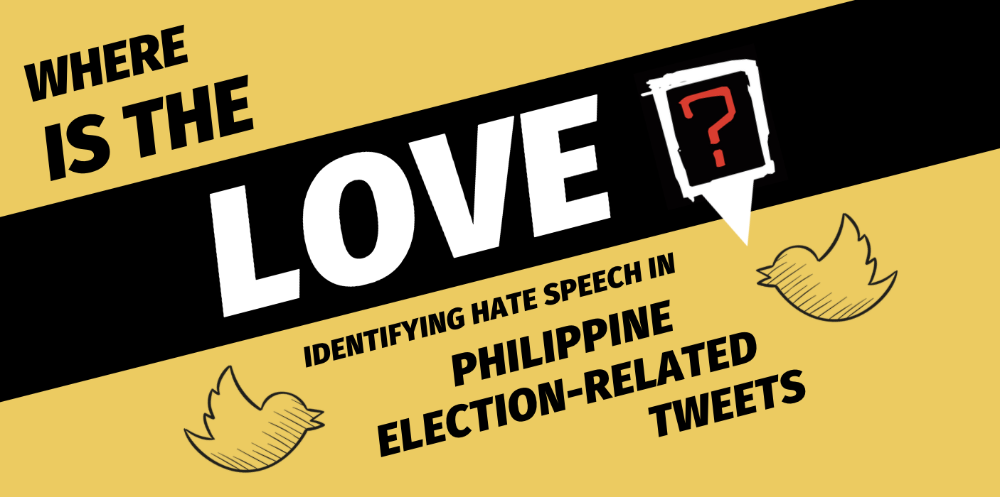

In [4]:
banner = Image.open('banner_title.png', 'r')
display(banner)

## Executive Summary

Increased usage of social media, particularly during election seasons, has intensified political division and hate speech. In line with this, this project aims to build a model that automatically detects hate speech and to understand patterns of political hate speech in a local context.

We used a dataset from Cabasag et. al. of tweets scraped during the 2016 Philippine electoral campaign that are labeled as hate and non-hate speech. We cleaned and processed the data using various NLP methods such as TF-IDF. We then built various machine learning classifier models including linear, tree-based, and multilayer perceptron models and then performed hyperparameter tuning to arrive at the best model based on the accuracy metric and the corresponding runtime. The best model was then used to test another dataset made up of recently scraped and manually labeled tweets about the 2022 elections. Finally, we employed SHAP to understand the factors that contribute to hate speech on a global scale, and we also used another interpretability method, LIME, to interpret the results on a more local level.

Among the models built, Logistic Regression had among the best accuracies, with the shortest runtime. This same model trained on 2016 data was then used to classify tweets from the present election campaign season. Global and local interpretability were then used to derive real-world insights from the results.

Some of the key findings after interpreting the results are that netizens naturally use certain keywords and nicknames when bashing candidates, with their sentiments varying depending on the name of choice. Also, a common behavior found on specific candidates' supporters is that their hate tweets are also mostly directed to the other supporters rather than the opposing candidates themselves.

Political ads can also make or break a candidate's campaign as a negatively accepted ad is usually a cause of a huge volume of hate tweets online. Meanwhile, links to websites or external sources on a person’s tweet, depending on the election season, can be used to legitimately inform or could also be weaponized to use in hate mongering online.

To further improve the applicability of the model on future studies, it is highly recommended to use a larger 2022 election related dataset either for testing or retraining the model. The dataset is preferred to be balanced on hate and non-hate tweets. Labeling techniques such as semi-supervised learning can also be deployed to ease the difficulty of manual labeling

## 1. Introduction and Problem Statement

Twitter is one of the most popular social media platforms in the world, following a format of a microblogging site where users can instantly post information using character limited status messages. Aside from information, opinions and thoughts are also being shared in the site, sometimes with the aim of swaying public opinion.

In the context of the Philippines, where we are constantly ranked high globally, in terms of social media and internet usage, social media platforms play a big role in mentality development regarding various current social issues. Politics, particularly the elections, is no exemption in social media influence. Elections have seen a shift from the traditional campaigning into a more digital and virtual approach. The 2016 elections period was probably one of the most heavily affected by social media in recent history. We have seen how it was used to the advantage of several candidates and how it also contributed to the fall of other campaigns. In all of this, public engagement and exchange were some of the main drivers of this influence.

Now with the 2022 presidential elections approaching, polarization and use of hateful language are very much prevalent in social media. This not only results in mental consequences on users but also discourages proper discourse or dialogue among the citizenry. To improve the political climate and promote a safer space for civil participation, we must first be able to identify hate speech and understand the underlying sentiment of those that engage in it. 

Thus, we pose the following questions: 
- How can we detect the use of abusive and offensive language?
- How can we describe the patterns of hateful speech in the context of Philippine elections?

## 2. Motivation for the Study

The motivation behind this study is to address the highly polarized political environment we now live in by encouraging a safe space for public dialogue. The results of this study may be beneficial to several stakeholders. This may aid social media platforms and oversight bodies in monitoring hateful conduct. This model may also be employed by political campaigns to serve as preliminary opinion polls or to address public sentiment. Finally, Filipinos may be made more aware and have a greater sense of responsibility in sharing or engaging in political views on social media platforms. 

## 3. Methodology

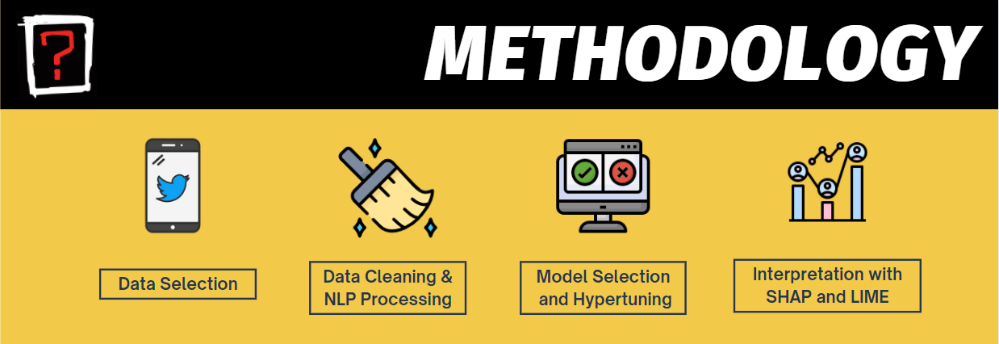

In [5]:
banner2 = Image.open('method.PNG', 'r')
display(banner2)

#### Data Selection and Processing

A total of 18,484 tweets, labeled as `hate` or `non-hate` tweets, were retrieved from a corpus of more than a million tweets related to the 2016 Philippine Presidential Elections. Data was cleaned by removing whitespaces and some special characters prior to pre-processing via tokenization and lemmatization.  The processed data was then subjected to vectorization using the Term Frequency Inverse Document Frequency `(TF-IDF)` algorithm. English and Filipino stop words were also used to deal with the bi-lingual complexity of the data set.

A `holdout set` was also prepared by scraping current election related tweets from the Twitter API. Keywords used for these tweets are all related to the upcoming 2022 PH elections. The same cleaning and pre-processing methods were applied to the tweets and were then manually labeled by the team as hate or non-hate.

#### Exploratory Data Analysis

EDA was then performed to establish the data distribution according to classification and candidate association. Prominent words were also determined using word clouds. Usage frequency of hashtags, mentions and external links were also explored. Lastly, tweet length in terms of characters and word count was also studied.

#### Model Selection & Hyperparameter Tuning

After preparing the data, models were then built using several machine learning algorithms. The classifier models used for this study are `Logistic Regression, Support Vector Machines (LSVM and RBFSVM), Decision Tree, Random Forest, Gradient Boosting Method` and `Neural Networks (Multi-layer Perceptron)`. Each model was then evaluated and improved using hyperparameter tuning methods and the model with the highest accuracy and best runtime was chosen as the final model. 

The chosen model was then used to evaluate the hold out set of 2022 PH election related tweets previously prepared by the team.

#### Interpretability

The results were then interpreted in a global and local level. Global or overall interpretability was analyzed using the `SHAP` method which determines the most important features and how much they contribute to the model’s general classification. Meanwhile, local interpretations were done using the `LIME` TextExplainer which visually shows how each word present in a datapoint contribute to the specific tweet’s classification.

## 4. Data Description and Pre-Processing

### 4.1 Data Source

The dataset was a sample set taken from a larger compilation of 2016 election related tweets scraped by Andrade et al. These tweets were taken from Twitter during the 2016 Philippine election period between November 2015 to May 2016. The tweets were scraped using keywords such as then presidential candidates:`Jejomar Binay`, `Mar Roxas`, `Rodrigo Duterte`, `Grace Poe` and `Miriam Defensor-Santiago`. Top hashtags from the same camapaign season were also used as keyword such as `#Halalan2016`, `PiliPinas2016` and `Eleksyon2016`. The final dataset had a total of 18464 unique tweet entries.

### 4.2 Data Extraction and Pre-Processing

The availability of data and the increasing power of computing drives several interest areas in the field of analytics to significant improvement, and one of them is `Natural Language Processing` (NLP). NLP is a branch of artificial intelligence that deals with a machine's capability to understand and interpret words in a way that humans do. It uses several concepts and techniques in statistics, machine learning and deep learning to create models that will help machines process languages in text or audio form. Text is broken down in order for the machine to handle input data for possible extraction, labeling, classification or analysis. Recently, one of the most common applications is sentiment analysis.

#### 4.2.1 Loading the dataset

First we load and take a first look at the 2016 election-related tweet dataset. The dataset comprises of 2 columns, `text` which holds the actual tweet contents and the column `label` which contains the designated label for non-hate `0` and hate `1` speech.

**Table 1. Sample 2016 Election Tweets and Labels**

In [6]:
pd.set_option('display.max_colwidth', None)
df = pd.read_csv('hatespeech_clean.csv')
display(df.sample(10, random_state=1).reset_index(drop=True))
pd.set_option('display.max_colwidth', 50)

,text,label
0,"Biskan Roxas, Poe nalang please. ?? #Election2016 #Halalan2016",0
1,Nagwawala na po itong katabi ko porket lamang lang si duterte ayyyy kaya pang habulin ni POE yann!!!!,0
2,Kadramaha neto ni Binay.,1
3,"In fairness. Nagpapaka-Honasan si Cayetano. ""Wag na ko, si Binay na lang."" ""Wag na ko, si Mayor Duterte na lang."" #TheLeaderIWant",0
4,"Binay: ""Such display of pettiness and bullying unmask the lie behind the claim of the acting Makati leadership of good governance.""",0
5,RT @hadji_addu: One need not be an astute political scientist to predict the absolutely certain loss of Mar Roxas in 2016 Elections.The sta…,0
6,"Nognog Binay, you're so annoying. Hays ??",1
7,"At Philippine Business Conf and Expo. Presidential bets Roxas, Binay and Santiago will be here today #PHvote https://t.co/5Ehio6OaYp",0
8,That ad about the allegations against Binay. Who is behind it? Binay himself?,1
9,Nakaka-urong ng kilig itong ads ni Dark Lord Binay!!! Mygahd. #OTWOLHarana,1


#### 4.2.2 Data Cleaning 

Regular expressions (also known as regex) is then used to clean up the corpora of tweets, by performing the following:

* Removing trailing whitespaces
* Replace whitespaces (`\t`,`\n`)
* Removing digits (`\d+`)
* Changing special characters (`'`, `"`)

In [7]:
df['text'] = df['text'].replace(r'\n', ' ', regex=True) 
df['text'] = df['text'].replace(r'\t', ' ', regex=True) 
df['text'] = df['text'].replace(r' \d+', ' ', regex=True)
df['text'] = df['text'].replace(r"'", '', regex=True)
df['text'] = df['text'].replace(r"’", '', regex=True)
df['text'] = df['text'].replace(r'/t', ' ', regex=True)
df['text'] = df['text'].str.lower()

#### 4.2.3 Tokenization and Lemmatization

The data is then prepared for subsequent transformation into numerical data by two additional pre-procesisng steps: tokenization and lemmatization. `Tokenization` refers to the processes of splitting a a document into into individual words or terms. `Lemmatization` refers to standarizing different forms of a word into their common root word (or lemma) so they might be analyzed as one item.

In [8]:
#Tokenization
df['tokenized'] = df['text'].apply(word_tokenize)

#Lemmatization
def lemmatize_text(text):
    lemmatizer = WordNetLemmatizer()
    return [lemmatizer.lemmatize(w) for w in text]

df['lemmatized'] = df['tokenized'].apply(lemmatize_text)
df['lemmatized'] = df['lemmatized'].str.join(" ")

#### 4.2.4 TF-IDF Vectorization

Term Frequency Inverse Document Frequency (TF-IDF) is a text vectrorization algorithm that combines two important features of text data. The first part, `Term Frequency` (TF) refers to the ratio of a word's occurence to the total number of words per document or in this case, a single tweet. Meanwhile the second part, `Inverse Document Frequency` (IDF) put importance on the word's occurence in several documents, in our case the count of the word's occurence in multiple tweets in the whole dataset. It gives a weight based on this frequency, with a higher value given to words present in less documents, implying its importance to that particular document.

The combination of these two features counterbalances the number of times a word appears in the document with the number of documents in which the particular word is present. 

The `TFIDFVectorizer` uses stopwords to remove words not needed in the processing. `Stopwords` are words that appear frequently in documents but are usually not considered insightful. For example words like 'a', 'an', or 'the' can be considered as stopwords. For the English language, there are default sets of stopwords used but these can also be subject to customization depending on the use. For our study an additional set of stopwords was included corresponding to pre-identified stopwords for the `Filipino` language.

Other parameters used in TFIDF to limit the word features are min_df and max_df. Removal of rare words is handled by the `min_df` parameter meanwhile those that appear too frequently on different documents are handled by the `max_df` parameter. Another paramater is `ngram_range` which determines the maximum combination of words that can be considered as unique word features. In our study, the setting was set at (1,2) which means that `unigrams` (solo words) or `bigrams` (2 word combinations) will be considered as unique features. There are 6,511 unique items after vectorizing.

In [9]:
newStopWords = ['ha','wa', 'u', 
                "ng","sa","na","mga","ang","ay","at","isang","ito",
                "ni","may","bilang","si","hindi","noong","mula",
                "para","kung","nito","pang","tao","pag","upang",
                "kanyang","siya","iba","rin","ibang","kanilang",
                "dahil","pa","lamang","isa","din","maaaring","nasa",
                "niya","nang","pamamagitan","kay","hanggang","ilang",
                "akin","aking","ako","alin","am","amin","aming","ang",
                "ano","anumang","apat","at","atin","ating","ay",
                "bababa","bago","bakit","bawat","bilang","dahil",
                "dalawa","dapat","din","dito","doon","gagawin",
                "gayunman","ginagawa","ginawa","ginawang","gumawa",
                "gusto","habang","hanggang","hindi","huwag","iba",
                "ibig","ikaw","ilagay","ilalim",
                "ilan","inyong","isa","isang","itaas","ito","iyo",
                "iyon","iyong","ka","kahit","kailangan","kailanman",
                "kami","kanila","kanilang","kanino","kanya","kanyang",
                "kapag","kapwa","karamihan","katiyakan","katulad",
                "kaya","kaysa","ko","kong","kulang","kumuha","kung",
                "laban","lahat","lamang","likod","lima","maaari",
                "maaaring","maging","mahusay","makita","marami",
                "marapat","masyado","may","mayroon","mga","minsan",
                "mismo","mula","muli","na","nabanggit","naging",
                "nagkaroon","nais","nakita","namin","napaka","narito",
                "nasaan","ng","ngayon","ni","nila","nilang","nito",
                "niya","niyang","noon","o","pa","paano","pababa",
                "paggawa","pagitan","pagkakaroon","pagkatapos",
                "palabas","pamamagitan","panahon","pangalawa","para",
                "paraan","pareho","pataas","pero","pumunta",
                "pumupunta","sa","saan","sabi","sabihin","sarili",
                "sila","sino","siya","tatlo","tayo","tulad",
                "tungkol", "una","wala", "walang"]

my_stop_words = text.ENGLISH_STOP_WORDS.union(newStopWords)
# my_stop_words

**Table 2. Sample of TF-IDF Vectorized Data for 2016 Election Tweets**

In [10]:
tfidfvec = TfidfVectorizer(stop_words=my_stop_words,
                           token_pattern=u'(?ui)\\b[a-z]+\\b',
                           ngram_range=(1,2), min_df=5, max_df=0.9)

tfidf_tokenized = tfidfvec.fit_transform(df["lemmatized"])
feature_array = tfidfvec.get_feature_names_out()

# print(len(feature_array))
df_tfidf = pd.DataFrame(tfidf_tokenized.toarray(), columns=feature_array)
df_tfidf.head()

,ab,ab cbn,aba,abad,abandoned,abangan,abay,abaya,abby,abby binay,...,yung tvc,yung vote,yung wag,z,zapanta,zapanta http,zenszei,zero,zero vote,zoned
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


## 5. Exploratory Data Analysis (EDA)

Exploratory data analysis (EDA) is done as a step to initially determine underlying patterns, noteworthy relations, and structure between data. It can give a preliminary analysis or summary of the data’s main characteristics and provide insights as well. EDA is also a way of identifying errors, biases, and outliers present in the current dataset. This process may be used as an evaluation of the data’s validity and if feature engineering is needed. Some initial benchmarks or metrics could also be established after EDA.

Data distribution is an important aspect to check because imbalance is critical when it comes to classification problems. For our dataset, the two main classes are `hate` and `non-hate` and each class has a substantial amount of data points. The dataset comprises of `9,864` (53.4%) non-hate tweets and `8,600` (46.6%) hate tweets for a total of `18,464` (Figure 1).

A benchmark was also computed in terms of our future model’s accuracy by using the `Proportional Chance Criterion`. This metric determines the minimum accuracy that the model must generate to be considered better than a classification based only on chance. The PCC is multiplied by 1.25 to give an extra buffer to our benchmark and the computed `1.25 x PCC` is seen below.

In [11]:
df_hate = df_tfidf[df['label']==1]
df_nonhate = df_tfidf[df['label']==0]

**Figure 1. Proportions of Non-hate vs. Hate speech in the 2016 Election Dataset**

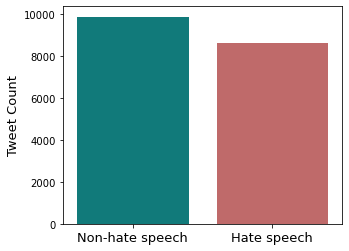

1.25 x Proportional Chance Criterion (PCC): 62.7929%


In [12]:
fig, ax = plt.subplots(figsize=(5, 4))
# fig.suptitle('Proportions of hate speech in the dataset', fontsize=14)
sns.barplot(x=["Non-hate speech", "Hate speech"],
            y=[len(df_nonhate), len(df_hate)], palette=['darkcyan', 'indianred'])
plt.ylabel('Tweet Count', fontsize=13)
plt.xticks(fontsize=13)
plt.show()
print(f"1.25 x Proportional Chance Criterion (PCC): "
      f"{(df['label'].value_counts(normalize=True)**2).sum()*1.25:.4%}")

The tweet distribution per candidate was also checked based on the mention of some keyword pertaining to the candidate names. Note that variations from the common name of the candidates were not considered here. As the results in Figure 2 show, majority of the tweets for both hate and non-hate classes are related to the former Vice President `Jejomar Binay` followed by `Mar Roxas`. Each candidate also has more non hate tweets associated with them compared to hate tweets. Mar Roxas probably has the smallest margin between the two tweet types at 3129 against 3104.

**Figure 2. Count of Name Mentions per Candidate, by non-hate vs hate speech**

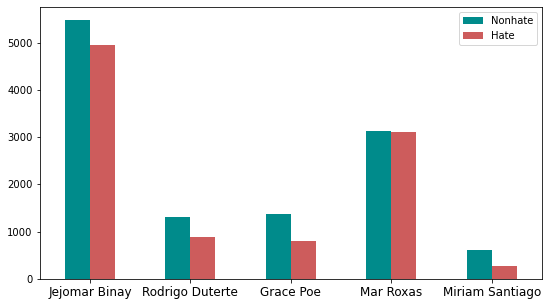

In [13]:
candidate_names = {'Jejomar Binay': ['jejomar', 'binay', 'jejomar binay'],
                   'Rodrigo Duterte': ['rodrigo', 'duterte', 'rodrigo duterte'],
                   'Grace Poe': ['grace', 'poe', 'grace poe'],
                   'Mar Roxas': ['mar', 'roxas', 'mar roxas'],
                   'Miriam Santiago': ['miriam', 'santiago', 'miriam santiago']}

tweet_summary = pd.DataFrame(index=candidate_names.keys(), columns=['Nonhate', 'Hate'])
nonhate_tweets = []
hate_tweets = []

for i, j in candidate_names.items():
    nonhate_tweets.append((df_nonhate[j].sum(axis=1) > 0).sum())
    hate_tweets.append((df_hate[j].sum(axis=1) > 0).sum())

tweet_summary['Nonhate'] = nonhate_tweets
tweet_summary['Hate'] = hate_tweets

# display(tweet_summary)

fig, ax = plt.subplots(figsize=(9, 5))
tweet_summary.plot.bar(ax=ax, color=['darkcyan', 'indianred'])
plt.xticks(rotation=0, fontsize=12)
plt.show()

Word clouds were also generated for additional insights. The larger words represent the more frequent words in our data set and these could be attributed to their impact or significance in our study. After vectorization and the corresponding filtering of stopwords, a word cloud was generated for non hate (Figure 3), hate (Figure 4) and all tweets (Figure 5) in our dataset.

For the non-hate tweets, prominent words are mostly related to two personalities, Binay and Roxas, consistent with their tweet counts previously. Other notable words aside from candidate names are `http`, `president`, `vote` and `good`.

**Figure 3. Word Cloud for Non-hate Speech in 2016 Election Tweets**

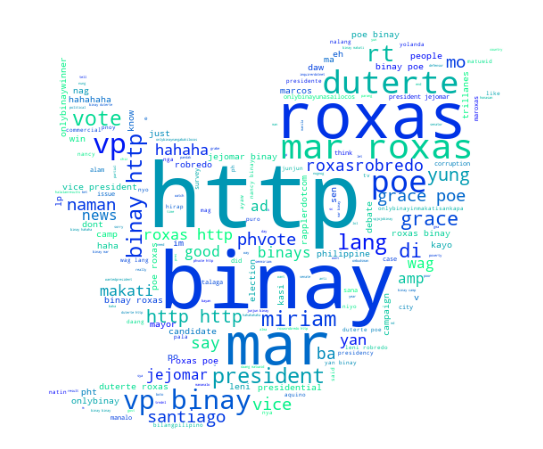

In [14]:
tweet_mask = np.array(Image.open('tweet_happy.png'))

wordcloud = (WordCloud(background_color='white', mask=tweet_mask,
                       colormap='winter', contour_width=0,
                       contour_color='green', random_state=42).
             generate_from_frequencies(df_nonhate.sum(axis=0)))
plt.figure(figsize=(12, 8))
ax = plt.gca()
# ax.set_title("Word Cloud for Non-hate Speech", ha='center',
#              fontsize=14, pad=30)
plt.axis('off')
plt.imshow(wordcloud)
plt.show()

Meanwhile for hate speech tweets, there are more words that stand out aside from those related to the candidates names. Some of the top words are `ayawsadilaw`, `nognog`, `commercial`, `pandak`, `talaga` and several expletives. `Http` was also a common word for hate tweets but is relatively less significant as compared to non-hate tweets.

**Figure 4. Word Cloud for Hate Speech in 2016 Election Tweets**

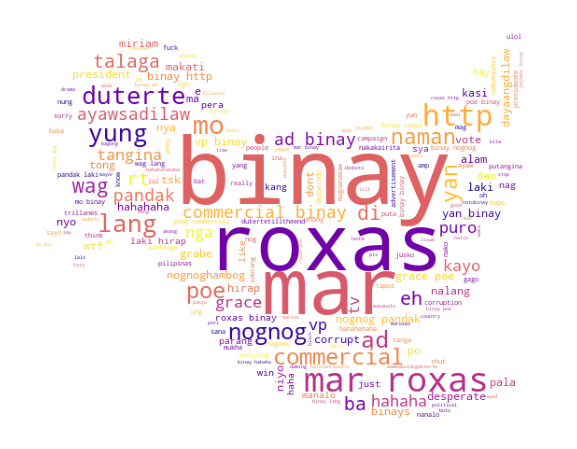

In [15]:
# tweet_mask = np.array(ImageOps.mirror(Image.open('tweet_stencil.png')))

tweet_mask = np.array(ImageOps.mirror(Image.open('tweet_mad.png')))

wordcloud = (WordCloud(background_color='white', mask=tweet_mask,
                       colormap='plasma', contour_width=0,
                       contour_color='violet', random_state=42).
             generate_from_frequencies(df_hate.sum(axis=0)))
plt.figure(figsize=(12, 8))
ax = plt.gca()
# ax.set_title("Word Cloud for Hate Speech", ha='center',
#              fontsize=14, pad=30)
plt.axis('off')
plt.imshow(wordcloud)
plt.show()

As expected with an almost balanced dataset, the same keywords are exhibited when evaluating the whole dataset. 

**Figure 5. Word Cloud for all 2016 Election-Related Tweets**

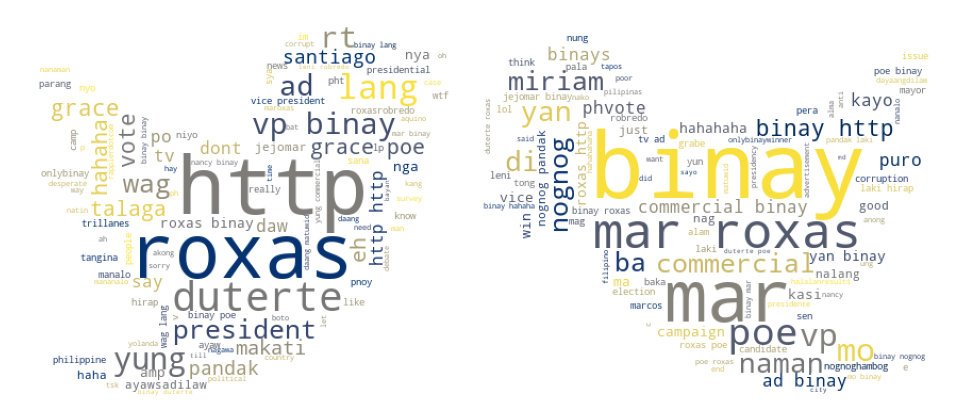

In [16]:
tweet_mask = np.array(ImageOps.mirror((Image.open('tweet_both.png'))))

wordcloud = (WordCloud(background_color='white', mask=tweet_mask,
                       colormap='cividis', contour_width=0,
                       contour_color='gray', random_state=0).
             generate_from_frequencies(df_tfidf.sum(axis=0)))
plt.figure(figsize=(17, 9))
ax = plt.gca()
# ax.set_title("Word Cloud for All Tweets", ha='center',
#              fontsize=14, pad=30)
plt.axis('off')
plt.imshow(wordcloud)
plt.show()

Hastags are single or multiple strings of words preceeded by a `hash #` sign used to categorize tweets or other content. It is an easier way to look for tweets of the same topic or theme. In our study, hashtags were not omiited. Shown below (Figure 6) are the most used hashtags based on our dataset.

Some of the major hashtags involve the keywords used when scraping the tweets which includes the popular elections hashtags `halalan2016`, `eleksyon2016` and `voteph`. The top hashtag was `pilipinasdebates2016` indicating a huge interest from twitter users on the conducted presidential debates. This may demonstrate the effectivity and the engagement generated by such activities to people active on social media. Other hashtags are candidate and campaign slogan related like `roxasrobredo`, `duterte2016` and `onlybinay`. Meanwhile some of them are propaganda related like `ayawsadilaw`, `dayaangdilaw` and `nognoghambog`.

**Figure 6. Most Frequently Used Hashtags**

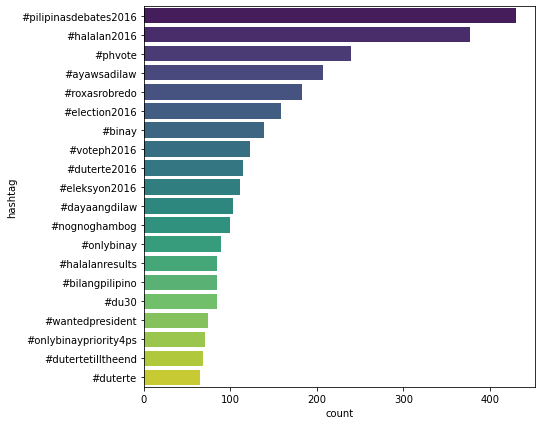

In [17]:
# filter hashtags
hashtag_list = (df.text.str.findall(r'#.*?(?=\s|$)')).tolist()
hashtag_list = list(itertools.chain.from_iterable(hashtag_list))
hashtag_list = list(map(lambda x: x.lower(), hashtag_list))

# count hashtags
df_hashtag = pd.DataFrame.from_dict(Counter(hashtag_list), 
                                    orient='index', 
                                    columns = ['count']).reset_index()
df_hashtag = df_hashtag.rename(columns = {'index': 'hashtag'})
top20 = df_hashtag.sort_values('count', ascending=False).head(20)

# plot
fig, ax = plt.subplots(figsize=(7, 7))
ax = sns.barplot(y = top20['hashtag'], x = top20['count'], data = top20,
                 orient='h', palette='viridis')

ax.set(xlabel='count', ylabel='hashtag')
plt.show()

`Mentions` which may be in the form of replies or direct tagging, are another measure of user engagement. The top mentions involve two major groups, the first one is the `candidates` group with Mar Roxas receiving the most mentions followed by Jejomar Binay and Grace Poe. The second group is the `news outlet` group comprising of major news institutions like Rappler, Inquirer, ABS-CBN News, GMA News, Manila Bulletin, Philippine Star and the former journalist JV Arcena of TV5.

**Figure 7. Most Frequent Mentions**

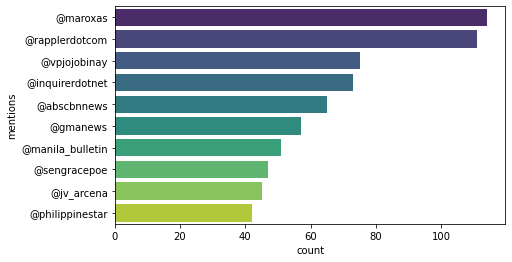

In [18]:
# filter mentions
mention_list = (df.text.str.findall(r'@.+?(?=\s|$)')).tolist()
mention_list = list(itertools.chain.from_iterable(mention_list))
mention_list = list(map(lambda x: x.lower(), mention_list))

# count mentions
df_mentions = pd.DataFrame.from_dict(Counter(mention_list), 
                                    orient='index', 
                                    columns = ['count']).reset_index()
df_mentions = df_mentions.rename(columns = {'index': 'mentions'})
top10 = df_mentions.sort_values('count', ascending=False).head(10)

# plot
fig, ax = plt.subplots(figsize=(7, 4))
ax = sns.barplot(y = top10['mentions'], x = top10['count'], data = top10,
                 orient='h', palette='viridis')

ax.set(xlabel='count', ylabel='mentions')
plt.show()

The tweets were scraped between 2015 and 2016 which meant that the character limit was still at 140 characters. Figure 8 shows that the distribution of both hate and non-hate tweets are fairly equal across different character lengths. Although it can be said that there are more non-hate tweets maximizing the character limit. The average word count per tweet (Figure 9) also shows an almost equal value for both non-hate (5.5 words) and hate (5.1) tweets. Overall, character and word count are not clear indicators in classifying tweets as hate or non-hate.

**Figure 8. Distribuion of Length of Tweets**

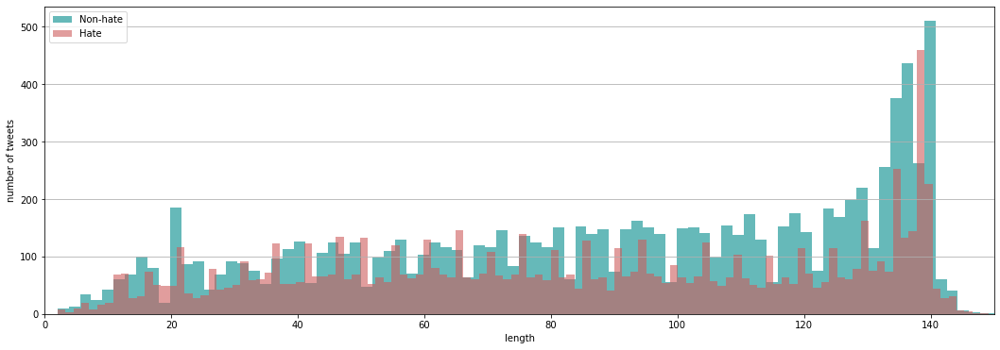

In [19]:
def length(text):    
    '''a function which returns the length of text'''
    return len(text)


df_copy = df.copy()
df_copy['length'] = df_copy['text'].apply(length)

plt.rcParams['figure.figsize'] = (18.0, 6.0)
bins = 140
plt.hist(df_copy[df_copy['label'] == 0]['length'], alpha = 0.6, bins=bins, label='Non-hate', color='darkcyan')
plt.hist(df_copy[df_copy['label'] == 1]['length'], alpha = 0.6, bins=bins, label='Hate', color='indianred')
plt.xlabel('length')
plt.ylabel('number of tweets')
plt.legend(loc='best')
plt.xlim(0,150)
plt.grid(axis='y')
plt.show()

**Figure 9. Distributions of Average Word Length Per Tweet**

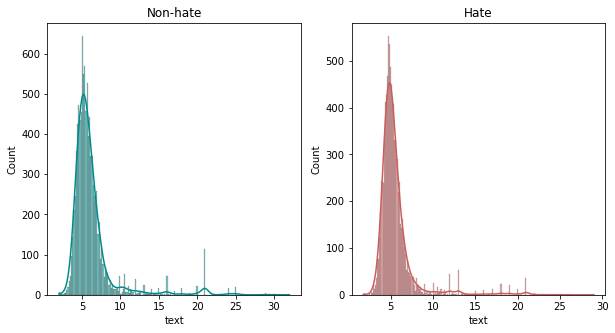

In [20]:
fig,(ax1,ax2)=plt.subplots(1,2,figsize=(10,5))
word=df_copy[df_copy['label']==0]['text'].str.split().apply(lambda x : [len(i) for i in x])
sns.histplot(word.map(lambda x: np.mean(x)), ax=ax1, color='darkcyan', kde=True)
ax1.set_title('Non-hate')
word=df_copy[df_copy['label']==1]['text'].str.split().apply(lambda x : [len(i) for i in x])
sns.histplot(word.map(lambda x: np.mean(x)), ax=ax2, color='indianred', kde=True)
ax2.set_title('Hate')
# fig.suptitle('Average word length in each tweet');
plt.show()

Finally, we take a look at tweets that primarily reference other sources; either containing links to various websites, or were posted in response to another tweet. 30% of the tweets included external links meanwhile only a few (10%) were direct responses to other tweets.

**Table 3. Tweets Referncing External Sources**

In [21]:
# no of tweets with external links
link_list = (df.text.str.findall(r'http.*?(?=\s|$)')).tolist()
link_list = list(itertools.chain.from_iterable(link_list))
# print(f'The dataset contains {len(link_list)} links to other websites.')

# no of replies
reply_list = (df.text.str.findall(r'^@.*?(?=\s|$)')).tolist()
reply_list = list(itertools.chain.from_iterable(reply_list))
# print(f'The dataset contains {len(reply_list)} replies to other tweets.')

pd.DataFrame([['Links to other websites', len(link_list)],
             ['Replies to other tweets', len(reply_list)]],
             columns=['References to other sources', 'Count']).set_index('References to other sources')

,Count
References to other sources,
Links to other websites,5719
Replies to other tweets,1783


## 6. Machine Learning

Having prepared and explored the dataset, we then build a classifier model using different machine learning algorithms, before proceeding to evaluate each and then select the model with the best overall performance. For this study, the following classifier methods were considered:

- **Logistic Regression** is a method that uses a logistic or sigmoid function to model a binary dependent variable.
- **Support Vector Machines (SVM)** find a hyperplane that distinctly separates data points into different classes. Different functions or "kernels", such as the linear and radial basis functions, are used to transform the input data into a form that is amenable to classification. In this study, we use LSVM and RBFSVM  to refer to the Linear SVM and Radial Basis Function SVM, respectively.
- **Decision Tree** is a model that uses a series of "if-then" rules to segment or split the feature space, until all data points are assigned to a target class.
- **Random Forest** is a model that uses an ensemble of decision trees and uses the average result in order to assign classes
- **Gradient Boosting Method** is a stage-wise additive model that generates an ensemble of weak decision trees, and successively learns from each
- **Neural networks** are models inspired by biological systems that uses layers of nodes to allow complex, hidden, or nonlinear correlations between independent variables (the input layer) and the the dependent variable (the output layer), using various functions.

Other models were attempted as well, such as the k-Nearest Neighbor and Naive Bayes models, however early testing showed poor results while also proving computationally prohibitive for this dataset (potentially causing devices to crash), and hence were removed from further consideration.

For the performance metric, we select *accuracy* as the primary model performance metric, for several reasons. Firstly, as seen in our data exploration, the dataset is highly balanced, and so accuracy would not suffer from misleading results as might be the case for highly imbalanced datasets. Secondly, we are equally interested in how well the model predicts both hate and non-hate speech, in fulfillment of the various study objectives or allowing safe spaces on social media platforms, while also being a tool to analyze public sentiment or past campaigns. Thirdly, we want the results to be easily communicable to the public, and accuracy is a well-known and easy-to-understand metric.

### 6.1 Model Training and Evaluation Using 2016 PH Election Data

Having selected the models and the performance metric, we then proceed to split the labeled dataset into a training and validation set, as well as a holdout set. 

For the training and validation set, different models were evaluated using `StratifiedKFold` as a cross-validation method, and `GridSearchCV` to efficiently find the optimal set of hyperparameters that would yield the best results. The models with the best-performing hyperparameter values were then applied on the holdout set as a final measure of performance. The findings were then tabulated and plotted accordingly.

*Note to Reader: When viewing this report as a Jupyter Notebook, the code cells for training the different models are commented out, so as to prevent prohibitively long run times. Instead of re-training the model every time the notebook is run, the trained models were saved as external `.pkl` files and loaded as needed to compare their performance or make predictions.*

In [22]:
# # Initialize inputs: trainval and holdout set, use stratify=y, test_size=0.25
X, y = df_tfidf, df.label
(X_trainval, X_holdout, y_trainval, y_holdout) = train_test_split(X, y,
                                           random_state=11, test_size=0.25, 
                                           stratify=y)

# Choose metric to be used for model selection
scoring = ['accuracy', 'precision', 'recall', 'f1', 'average_precision']
metric = scoring[0]

In [23]:
# Logistic Regression

# pipeline_LR = Pipeline([
#         ('scale', None), # remove scaler if not needed
#         ('LR', LogisticRegression())])

# skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=11) # trainval splitting

# param_grid_LR = {'LR__C': [0.01, 0.1, 1, 10],
#                  'LR__penalty' : ['l1', 'l2'],
#                  'LR__solver' : ['liblinear']}

# grid_search_LR = GridSearchCV(estimator=pipeline_LR, scoring=metric,
#                                cv=skf, n_jobs=-1, return_train_score=True,
#                                param_grid=param_grid_LR)

# # fit and predict
# grid_search_LR.fit(X_trainval, y_trainval)
# y_preds_LR = grid_search_LR.predict(X_holdout)

# # holdout scores
# holdout_acc_LR = round(accuracy_score(y_holdout, y_preds_LR)*100, 2)
# holdout_prec_LR = round(precision_score(y_holdout, y_preds_LR, pos_label=1)*100, 2)
# holdout_rec_LR = round(recall_score(y_holdout, y_preds_LR, pos_label=1)*100, 2)
# holdout_f1_LR = round(f1_score(y_holdout, y_preds_LR, pos_label=1)*100, 2)
# holdout_auc_pr_LR = round(average_precision_score(y_holdout, y_preds_LR)*100, 2)

# holdout_dict = {
#     'accuracy': holdout_acc_LR,
#     'precision': holdout_prec_LR,
#     'recall': holdout_rec_LR,
#     'f1': holdout_f1_LR,
#     'average_precision': holdout_auc_pr_LR
# }

# # LR total run time
# total_time_LR = np.sum(grid_search_LR.cv_results_['mean_fit_time']) + np.sum(grid_search_LR.cv_results_['mean_score_time'])
# LR_time = total_time_LR

# df_LR_tuned = pd.DataFrame(
# {
#     metric: [round(grid_search_LR.best_score_*100, 2)],
#     'holdout_score': [holdout_dict[metric]],
#     'params': [grid_search_LR.best_params_],
#     'total_run_time': [total_time_LR]
# }, index=['LR'])

# joblib.dump(grid_search_LR, 'LR_Rerun.pkl')
# joblib.load("LR_Rerun.pkl")

In [24]:
# LSVM (Tuned)

# pipeline_LSVM = Pipeline([
#         ('scale', None), # remove scaler if not needed
#         ('LSVM', SVC(kernel='linear'))])

# skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=11) # trainval splitting

# param_grid_LSVM = {'LSVM__C': [0.1, 1, 10]}

# grid_search_LSVM = GridSearchCV(estimator=pipeline_LSVM, scoring=metric,
#                                cv=skf, n_jobs=-1, return_train_score=True,
#                                param_grid=param_grid_LSVM)

# # fit and predict
# grid_search_LSVM.fit(X_trainval, y_trainval)
# y_preds_LSVM = grid_search_LSVM.predict(X_holdout)

# # holdout scores
# holdout_acc_LSVM = round(accuracy_score(y_holdout, y_preds_LSVM)*100, 2)
# holdout_prec_LSVM = round(precision_score(y_holdout, y_preds_LSVM, pos_label=1)*100, 2)
# holdout_rec_LSVM = round(recall_score(y_holdout, y_preds_LSVM, pos_label=1)*100, 2)
# holdout_f1_LSVM = round(f1_score(y_holdout, y_preds_LSVM, pos_label=1)*100, 2)
# holdout_auc_pr_LSVM = round(average_precision_score(y_holdout, y_preds_LSVM)*100, 2)

# holdout_dict = {
#     'accuracy': holdout_acc_LSVM,
#     'precision': holdout_prec_LSVM,
#     'recall': holdout_rec_LSVM,
#     'f1': holdout_f1_LSVM,
#     'average_precision': holdout_auc_pr_LSVM
# }

# # LSVM total run time
# total_time_LSVM = np.sum(grid_search_LSVM.cv_results_['mean_fit_time']) + np.sum(grid_search_LSVM.cv_results_['mean_score_time'])
# LSVM_time = total_time_LSVM

# df_LSVM_tuned = pd.DataFrame(
# {
#     metric: [round(grid_search_LSVM.best_score_*100, 2)],
#     'holdout_score': [holdout_dict[metric]],
#     'params': [grid_search_LSVM.best_params_],
#     'total_run_time': [total_time_LSVM]
# }, index=['LSVM'])

# joblib.dump(grid_search_LSVM, 'LSVM_Rerun.pkl')
# joblib.load("LSVM_Rerun.pkl")

In [25]:
# RBFSVM (Tuned)

# pipeline_RBFSVM = Pipeline([('scale', None),('RBFSVM', SVC(kernel='rbf'))])

# skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=11) # trainval splitting

# param_grid_RBFSVM = {'RBFSVM__C': [0.1, 1, 10]}

# grid_search_RBFSVM = GridSearchCV(estimator=pipeline_RBFSVM, scoring=metric,
#                                cv=skf, n_jobs=-1, return_train_score=True,
#                                param_grid=param_grid_RBFSVM)

# # fit and predict
# grid_search_RBFSVM.fit(X_trainval, y_trainval)
# y_preds_RBFSVM = grid_search_RBFSVM.predict(X_holdout)

# # holdout scores
# holdout_acc_RBFSVM = round(accuracy_score(y_holdout, y_preds_RBFSVM)*100, 2)
# holdout_prec_RBFSVM = round(precision_score(y_holdout, y_preds_RBFSVM, pos_label=1)*100, 2)
# holdout_rec_RBFSVM = round(recall_score(y_holdout, y_preds_RBFSVM, pos_label=1)*100, 2)
# holdout_f1_RBFSVM = round(f1_score(y_holdout, y_preds_RBFSVM, pos_label=1)*100, 2)
# holdout_auc_pr_RBFSVM = round(average_precision_score(y_holdout, y_preds_RBFSVM)*100, 2)

# holdout_dict = {
#     'accuracy': holdout_acc_RBFSVM,
#     'precision': holdout_prec_RBFSVM,
#     'recall': holdout_rec_RBFSVM,
#     'f1': holdout_f1_RBFSVM,
#     'average_precision': holdout_auc_pr_RBFSVM
# }

# # RBFSVM total run time
# total_time_RBFSVM = np.sum(grid_search_RBFSVM.cv_results_['mean_fit_time']) + np.sum(grid_search_RBFSVM.cv_results_['mean_score_time'])
# RBFSVM_time = total_time_RBFSVM

# df_RBFSVM_tuned = pd.DataFrame(
# {
#     metric: [round(grid_search_RBFSVM.best_score_*100, 2)],
#     'holdout_score': [holdout_dict[metric]],
#     'params': [grid_search_RBFSVM.best_params_],
#     'total_run_time': [total_time_RBFSVM]
# }, index=['RBFSVM'])

# joblib.dump(grid_search_RBFSVM, 'RBFSVM_Rerun.pkl')
# joblib.load("RBFSVM_Rerun.pkl")

In [26]:
# DT (Tuned)

# pipeline_DT = Pipeline([
#         ('scale', None), # remove scaler if not needed
#         ('DT', DecisionTreeClassifier(random_state=11))])

# skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=11) # trainval splitting

# param_grid_DT = {'DT__max_depth': [2, 3, 4, 5, 6]}

# grid_search_DT = GridSearchCV(estimator=pipeline_DT, scoring=metric,
#                                cv=skf, n_jobs=-1, return_train_score=True,
#                                param_grid=param_grid_DT)

# # fit and predict
# grid_search_DT.fit(X_trainval, y_trainval)
# y_preds_DT = grid_search_DT.predict(X_holdout)

# # holdout scores
# holdout_acc_DT = round(accuracy_score(y_holdout, y_preds_DT)*100, 2)
# holdout_prec_DT = round(precision_score(y_holdout, y_preds_DT, pos_label=1)*100, 2)
# holdout_rec_DT = round(recall_score(y_holdout, y_preds_DT, pos_label=1)*100, 2)
# holdout_f1_DT = round(f1_score(y_holdout, y_preds_DT, pos_label=1)*100, 2)
# holdout_auc_pr_DT = round(average_precision_score(y_holdout, y_preds_DT)*100, 2)

# holdout_dict = {
#     'accuracy': holdout_acc_DT,
#     'precision': holdout_prec_DT,
#     'recall': holdout_rec_DT,
#     'f1': holdout_f1_DT,
#     'average_precision': holdout_auc_pr_DT
# }

# # DT total run time
# total_time_DT = np.sum(grid_search_DT.cv_results_['mean_fit_time']) + np.sum(grid_search_DT.cv_results_['mean_score_time'])
# DT_time = total_time_DT

# df_DT_tuned = pd.DataFrame(
# {
#     metric: [round(grid_search_DT.best_score_*100, 2)],
#     'holdout_score': [holdout_dict[metric]],
#     'params': [grid_search_DT.best_params_],
#     'total_run_time': [total_time_DT]
# }, index=['DT'])

# joblib.dump(grid_search_DT, 'DT_Rerun.pkl')
# joblib.load("DT_Rerun.pkl")

In [27]:
# RF (Tuned)

# pipeline_RF = Pipeline([
#         ('scale', None), # remove scaler if not needed
#         ('RF', RandomForestClassifier(random_state=11))])

# skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=11) # trainval splitting

# param_grid_RF = {'RF__max_depth': [2, 3, 4, 5, 6], 
#                  'RF__n_estimators': [200]}

# grid_search_RF = GridSearchCV(estimator=pipeline_RF, scoring=metric,
#                                cv=skf, n_jobs=-1, return_train_score=True,
#                                param_grid=param_grid_RF)

# # fit and predict
# grid_search_RF.fit(X_trainval, y_trainval)
# y_preds_RF = grid_search_RF.predict(X_holdout)

# # holdout scores
# holdout_acc_RF = round(accuracy_score(y_holdout, y_preds_RF)*100, 2)
# holdout_prec_RF = round(precision_score(y_holdout, y_preds_RF, pos_label=1)*100, 2)
# holdout_rec_RF = round(recall_score(y_holdout, y_preds_RF, pos_label=1)*100, 2)
# holdout_f1_RF = round(f1_score(y_holdout, y_preds_RF, pos_label=1)*100, 2)
# holdout_auc_pr_RF = round(average_precision_score(y_holdout, y_preds_RF)*100, 2)

# holdout_dict = {
#     'accuracy': holdout_acc_RF,
#     'precision': holdout_prec_RF,
#     'recall': holdout_rec_RF,
#     'f1': holdout_f1_RF,
#     'average_precision': holdout_auc_pr_RF
# }

# # RF total run time
# total_time_RF = np.sum(grid_search_RF.cv_results_['mean_fit_time']) + np.sum(grid_search_RF.cv_results_['mean_score_time'])
# RF_time = total_time_RF

# df_RF_tuned = pd.DataFrame(
# {
#     metric: [round(grid_search_RF.best_score_*100, 2)],
#     'holdout_score': [holdout_dict[metric]],
#     'params': [grid_search_RF.best_params_],
#     'total_run_time': [total_time_RF]
# }, index=['RF'])

# joblib.dump(grid_search_RF, 'RF_Rerun.pkl')
# joblib.load("RF_Rerun.pkl")

In [28]:
# GBM (Tuned)

# pipeline_GBM = Pipeline([
#         ('scale', None), # remove scaler if not needed
#         ('GBM', GradientBoostingClassifier(random_state=11))])

# skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=11) # trainval splitting

# param_grid_GBM = {'GBM__max_depth': [4, 5, 6], 
#                  'GBM__n_estimators': [200],
#                  'GBM__learning_rate': [0.1]}

# grid_search_GBM = GridSearchCV(estimator=pipeline_GBM, scoring=metric,
#                                cv=skf, n_jobs=-1, return_train_score=True,
#                                param_grid=param_grid_GBM)

# # fit and predict
# grid_search_GBM.fit(X_trainval, y_trainval)
# y_preds_GBM = grid_search_GBM.predict(X_holdout)

# # holdout scores
# holdout_acc_GBM = round(accuracy_score(y_holdout, y_preds_GBM)*100, 2)
# holdout_prec_GBM = round(precision_score(y_holdout, y_preds_GBM, pos_label=1)*100, 2)
# holdout_rec_GBM = round(recall_score(y_holdout, y_preds_GBM, pos_label=1)*100, 2)
# holdout_f1_GBM = round(f1_score(y_holdout, y_preds_GBM, pos_label=1)*100, 2)
# holdout_auc_pr_GBM = round(average_precision_score(y_holdout, y_preds_GBM)*100, 2)

# holdout_dict = {
#     'accuracy': holdout_acc_GBM,
#     'precision': holdout_prec_GBM,
#     'recall': holdout_rec_GBM,
#     'f1': holdout_f1_GBM,
#     'average_precision': holdout_auc_pr_GBM
# }

# # GBM total run time
# total_time_GBM = np.sum(grid_search_GBM.cv_results_['mean_fit_time']) + np.sum(grid_search_GBM.cv_results_['mean_score_time'])
# GBM_time = total_time_GBM

# df_GBM_tuned = pd.DataFrame(
# {
#     metric: [round(grid_search_GBM.best_score_*100, 2)],
#     'holdout_score': [holdout_dict[metric]],
#     'params': [grid_search_GBM.best_params_],
#     'total_run_time': [total_time_GBM]
# }, index=['GBM'])

# joblib.dump(grid_search_GBM, 'GBM_Rerun.pkl')
# joblib.load("GBM_Rerun.pkl")

In [29]:
# MLP (Tuned)

# pipeline_MLP = Pipeline([
#         ('scale', StandardScaler()), # remove scaler if not needed
#         ('MLP', MLPClassifier(random_state=11))])

# skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=11) # trainval splitting

# param_grid_MLP = {
#     'MLP__activation': ['tanh', 'relu', 'logistic'],
#     'MLP__solver': ['sgd', 'adam'],
#     'MLP__alpha': [0.0001, 0.05],
#     'MLP__learning_rate': ['constant','adaptive'],
# }

# grid_search_MLP = GridSearchCV(estimator=pipeline_MLP, scoring=metric,
#                                cv=skf, n_jobs=-1, return_train_score=True,
#                                param_grid=param_grid_MLP)

# # fit and predict
# grid_search_MLP.fit(X_trainval, y_trainval)
# y_preds_MLP = grid_search_MLP.predict(X_holdout)

# # holdout scores
# holdout_acc_MLP = round(accuracy_score(y_holdout, y_preds_MLP)*100, 2)
# holdout_prec_MLP = round(precision_score(y_holdout, y_preds_MLP, pos_label=1)*100, 2)
# holdout_rec_MLP = round(recall_score(y_holdout, y_preds_MLP, pos_label=1)*100, 2)
# holdout_f1_MLP = round(f1_score(y_holdout, y_preds_MLP, pos_label=1)*100, 2)
# holdout_auc_pr_MLP = round(average_precision_score(y_holdout, y_preds_MLP)*100, 2)

# holdout_dict = {
#     'accuracy': holdout_acc_MLP,
#     'precision': holdout_prec_MLP,
#     'recall': holdout_rec_MLP,
#     'f1': holdout_f1_MLP,
#     'average_precision': holdout_auc_pr_MLP
# }

# # MLP total run time
# total_time_MLP = np.sum(grid_search_MLP.cv_results_['mean_fit_time']) + np.sum(grid_search_MLP.cv_results_['mean_score_time'])
# MLP_time = total_time_MLP

# df_MLP_tuned = pd.DataFrame(
# {
#     metric: [round(grid_search_MLP.best_score_*100, 2)],
#     'holdout_score': [holdout_dict[metric]],
#     'params': [grid_search_MLP.best_params_],
#     'total_run_time': [total_time_MLP]
# }, index=['MLP'])

# joblib.dump(grid_search_MLP, 'grid_search_MLP.pkl')
# joblib.load('grid_search_MLP.pkl')

In [30]:
# def results_df():
#     LR = joblib.load("LR_Rerun.pkl")
#     LSVM = joblib.load("LSVM_Rerun.pkl")
#     RBFSVM = joblib.load("RBFSVM_Rerun.pkl")
#     DT = joblib.load("DT_Rerun.pkl")
#     RF = joblib.load("RF_Rerun.pkl")
#     GBM = joblib.load("GBM_Rerun.pkl")
#     MLP = joblib.load('grid_search_MLP_final.pkl')
    

#     models = [LR, LSVM, RBFSVM, DT, RF, GBM, MLP]
#     model_names = ['Logistic Regression', 'LSVM', 'RBFSVM', 'Decision Tree',
#                    'Random Forest', 'Gradient Boosting Method',
#                    'Neural Network']
#     result_df = pd.DataFrame(columns=['params','mean_train_score','mean_test_score'])
    
#     for i, model in enumerate(models):
#         df_model = pd.DataFrame(model.cv_results_)
#         best_params = df_model.loc[df_model['rank_test_score'] == 1][['params', 'mean_train_score',
#                                                                       'mean_test_score']].iloc[[0]]
#         best_params['model_name'] = model_names[i]
#         y_preds = model.predict(X_holdout)
#         best_params['holdout_score'] = accuracy_score(y_holdout, y_preds)
#         best_params['total_run_time'] = np.sum(df_model['mean_fit_time']) + np.sum(df_model['mean_score_time'])
#         result_df = pd.concat([result_df, best_params], axis=0)

#     result_df = result_df.set_index('model_name')
#     return result_df


# df_summary = results_df()
# df_summary.to_pickle("model_summary.pkl")

#### Table 4. Summary of ML Results

In [31]:
pd.set_option('display.max_colwidth', None)
df_summary = pd.read_pickle("model_summary.pkl")

best_params = []
for i in df_summary['params']:
    params = ""
    for key, value in i.items():
        params = params + str(key.split('__')[1]) + ": " + str(value) + ";  "
    params = params[:-3]
    best_params.append(params)

df_summary['params'] = best_params
display(df_summary)

,params,mean_train_score,mean_test_score,holdout_score,total_run_time
model_name,,,,,
Logistic Regression,C: 1; penalty: l2; solver: liblinear,0.837666,0.753898,0.760182,43.818326
LSVM,C: 1,0.863211,0.752238,0.756282,7385.435408
RBFSVM,C: 1,0.941779,0.751227,0.762132,11974.362547
Decision Tree,max_depth: 6,0.623141,0.614745,0.608102,141.948006
Random Forest,max_depth: 6; n_estimators: 200,0.632546,0.621100,0.634099,158.731453
Gradient Boosting Method,learning_rate: 0.1; max_depth: 6; n_estimators: 200,0.825607,0.732958,0.739385,17758.795850
Neural Network,activation: logistic; alpha: 0.05; learning_rate: constant; solver: adam,0.877491,0.754693,0.756499,8788.611042


#### Figure 10. Bar Plot of ML Results

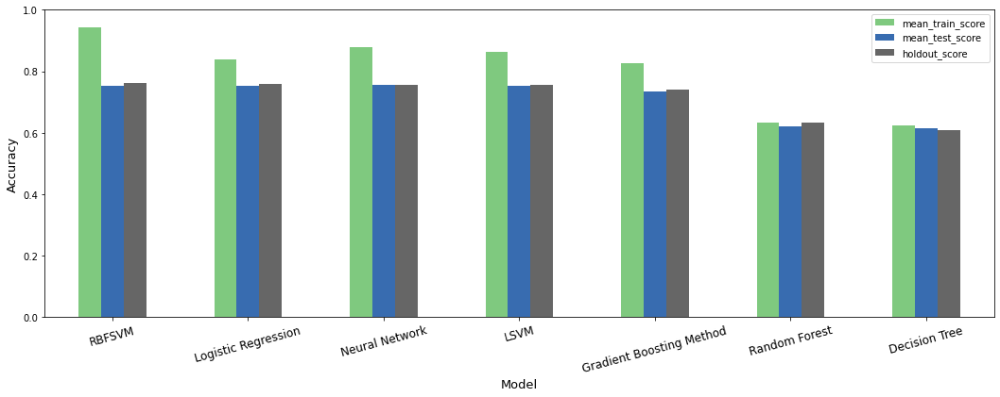

In [32]:
fig, ax = plt.subplots(figsize=(18, 6))
df_summary[['mean_train_score', 'mean_test_score', 'holdout_score']].sort_values('holdout_score', ascending=False).plot(kind='bar', colormap='Accent', ax=ax)
ax.set_ylim(0, 1)
ax.set_xlabel('Model', fontsize=13)
ax.set_ylabel('Accuracy', fontsize=13)
plt.xticks(rotation=15, fontsize=12)
plt.show()

**Figure 11. ML Model Runtimes**

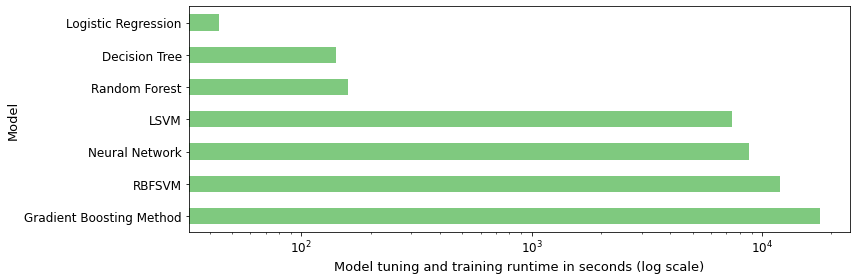

In [33]:
fig, ax = plt.subplots(figsize=(12, 4))
df_summary['total_run_time'].sort_values(ascending=False).plot(kind='barh', colormap='Accent', fontsize=12)
ax.set_xscale('log')
ax.set_xlabel('Model tuning and training runtime in seconds (log scale)', fontsize=13)
ax.set_ylabel('Model', fontsize=13)
plt.tight_layout()
plt.show()

It may be seen from the above plots that after hyperparameter tuning, the SVM Models, Logistic Regression,  Neural Network, and Gradient Boosting Method all had comparable performance when it came to the validation and holdout sets. All these models easily beat the $1.25 \times PCC$ benchmark of 62.8%. The Decision Tree and Random Forest models did not perform quite as well, with either the validation or holdout accuracy failing to beat the benchmark.

Based on the holdout accuracy, the top three models were RBFSVM, Logistic Regression, and Neural Network, with Logistic Regression featuring by far the best runtimes. It was thus decided to go with `Logistic Regression`, considering both its simplicity as well as its computational and predictive performance. The speed of training the model was considered useful should it ever be deployed in practice and periodically re-trained on large volumes of tweets and social media posts.

### 6.2 Applying the Model to 2022 PH Election Data

Having selected a model along with its optimal hyperparameters, and after training it on 2016 data, we seek to apply the same model to tweets relating to the 2022 Philippine election. The purpose is to provide some early indication if training the model on data related to one election is sufficient to provide a model that works to classify hate speech related to other elections and time periods.

Hence we proceeded to develop a new dataset, by scraping tweets using the Twitter API. The tweets were then manually labeled as hate or non-hate so as to turn it into something akin to a second test or holdout set, on which we could measure predictive accuracy and thus gauge the generalizability of the model.

In labelling the tweets, we exerted best effort in applying the same judgement that was used by those who prepared the original 2016 election-related dataset, wherein tweets that were mocking, sarcastic, or ridiculing were labelled as "hate", while those that were more objective, neutral, or positive in tone were labeled as "non-hate".

Although well over 700 current tweets related to the 2022 elections were extracted, the labeling process revealed many irrelevant or repetitive tweets, and so these were discarded from the dataset. This left 378 labeled tweets, which we cleaned and pre-processed using NLP techniques, then explored briefly before applying the trained Logistic Regression classifier.

**Table 5. Sample 2022 Election Tweets and Labels**

In [34]:
pd.set_option('display.max_colwidth', None)
df22 = pd.read_csv('2022_elections.csv')
display(df22.sample(10, random_state=1).reset_index(drop=True))
pd.set_option('display.max_colwidth', 50)

,text,label
0,Lacson-Sotto vow to buy 50% of farmers’ crops to boost agri sector. #Eleksyon2022 \n \n\n https://t.co/yeuA53J9bF,0
1,"RT @FirmInTheSouth: Donâ€™t worry. Weâ€™re all proud of you and surely, hindi masasayang boto mo.\n #UniTeam #Halalan2022 https://t.co/VQiCK0Zx61",0
2,Bong Go pinag-iisipan ang pag-urong sa kandidatura sa pagka-Pangulo https://t.co/7ELQ7Y519e via @YouTube,0
3,Pinaglalaruan lang ng mga ito ang eleksyon sa pinakamataas na posisyon ng bansa! \n \n\n Pero dami pa rin nauuto nila!… https://t.co/p1Obm7SBtw,1
4,From fake diploma to fake bongbong marcos. Jusko 😂😂😂 #NationwideDrugTest please!!! \n #Eleksyon2022 #BBMSara2022,1
5,"RT @beeravocadois: Maraming may Leni tarp sa Tipas, Taguig! Halos sunod2 na bahay meron. Pati tryk! Tapos sa Pateros hindi na kapulahan ang…",0
6,RT @gmanews: Presidential aspirant and Senator Panfilo Lacson on Thursday urged the Commission on Elections (Comelec) to closely coordinate…,0
7,"Jusko naman! Kakaloka yung Kamehameha! Anong sunod, Kagebunshin no jutsu? 🤦🏻‍♀️ #Eleksyon2022",1
8,"If Sen. Bong Go withdraws, and BBM gets disqualified, where do we go?\n Be careful what you wish for. \n I think it's bâ€¦ https://t.co/zPAI0OFJ9g",0
9,@smninews @Pilipinas2022 @Pilipinas2022 #BBMFORPRESIDENT2022,0


In [35]:
# Data Cleaning
df22['text'] = df22['text'].replace(r'\n', ' ', regex=True) 
df22['text'] = df22['text'].replace(r'\t', ' ', regex=True) 
df22['text'] = df22['text'].replace(r' \d+', ' ', regex=True)
df22['text'] = df22['text'].replace(r"'", '', regex=True)
df22['text'] = df22['text'].replace(r"’", '', regex=True)
df22['text'] = df22['text'].replace(r'/t', ' ', regex=True)
df22['text'] = df22['text'].str.lower()

# Tokenization and Lemmatization
df22['tokenized'] = df22['text'].apply(word_tokenize)
df22['lemmatized'] = df22['tokenized'].apply(lemmatize_text)
df22['lemmatized'] = df22['lemmatized'].str.join(" ")

# TF-IDF Vectorization
tfidf_tokenized22 = tfidfvec.transform(df22["lemmatized"])
feature_array22 = tfidfvec.get_feature_names()
df_tfidf22 = pd.DataFrame(tfidf_tokenized22.toarray(), columns=feature_array22)

# Separating into hate and non-hate datasets
df_hate22 = df_tfidf22[df22['label']==1]
df_nonhate22 = df_tfidf22[df22['label']==0]

It is worth noting that the analysts were limited to working with 2022 election data that could be extracted from the API and then manually labeled using time and resources available.  This dataset turned out to be imbalanced,  unlike the 2016 election dataset which, aside from being far more extensive, was already balanced before being made publicly available. Given the difference in proportions of hate vs non-hate speech, the accuracy score obtained on the 2022 election data may not be directly comparable to the the accuracy achieved on the 2016 dataset. It was deemed more appropriate to compare the resulting accuracy to the Proportional Chance Criterion, or PCC, which was found to be approximately 80%. (As previously mentioned, a typical benchmark is to use $1.25 \times PCC$, however in this instance, such a benchmark would exceed 100%.)

**Figure 12. Proportions of Non-hate vs. Hate speech in the 2022 Election Dataset**

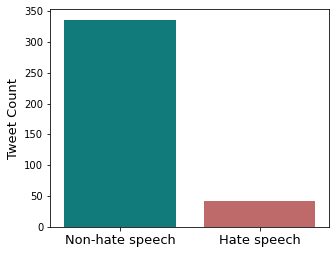

Proportional Chance Criterion (PCC): 80.2469%


In [36]:
fig, ax = plt.subplots(figsize=(5, 4))
# fig.suptitle('Proportions of hate speech in the dataset', fontsize=14)
sns.barplot(x=["Non-hate speech", "Hate speech"],
            y=[len(df_nonhate22), len(df_hate22)], palette=['darkcyan', 'indianred'])
plt.ylabel('Tweet Count', fontsize=13)
plt.xticks(fontsize=13)
plt.show()
print(f"Proportional Chance Criterion (PCC): {(df22['label'].value_counts(normalize=True)**2).sum():.4%}")

We also construct word clouds to provide some indication of the common keywords used currently in social media relating to the 2022 elections, for both the hate speech and non-hate speech datasets. While much overlap was observed, the hate speech word cloud reveals some more inflammatory or negative words like `fake`, `bobo`, and `wtf`.

**Figure 11. Word Cloud for Non-hate Speech for 2022 Election Tweets**

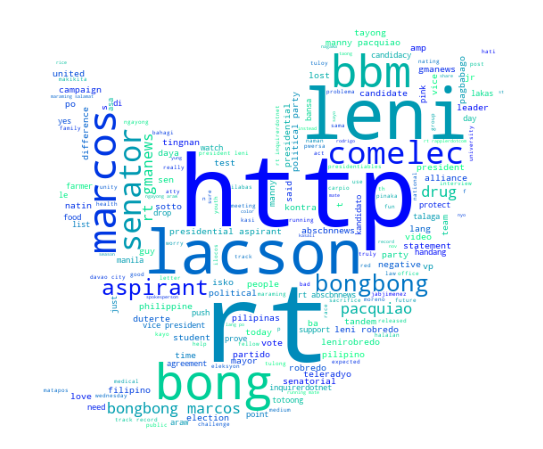

In [37]:
tweet_mask = np.array(Image.open('tweet_happy.png'))

wordcloud = (WordCloud(background_color='white', mask=tweet_mask,
                       colormap='winter', contour_width=0,
                       contour_color='green', random_state=42).
             generate_from_frequencies(df_nonhate22.sum(axis=0)))
plt.figure(figsize=(12, 8))
ax = plt.gca()
# ax.set_title("Word Cloud for Non-hate Speech", ha='center',
#              fontsize=14, pad=30)
plt.axis('off')
plt.imshow(wordcloud)
plt.show()

**Figure 12. Word Cloud for Hate Speech for 2022 Election Tweets**

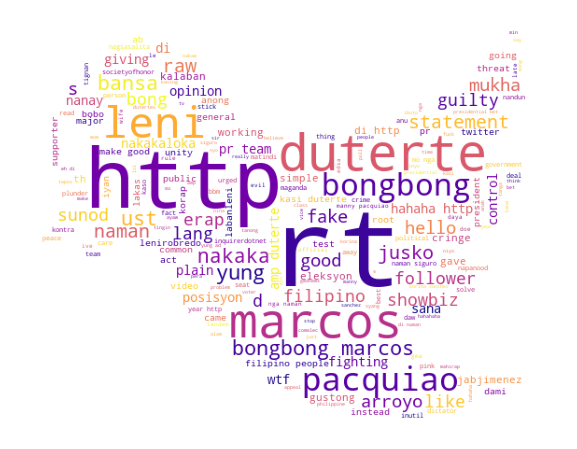

In [38]:
tweet_mask = np.array(ImageOps.mirror(Image.open('tweet_mad.png')))

wordcloud = (WordCloud(background_color='white', mask=tweet_mask,
                       colormap='plasma', contour_width=0,
                       contour_color='violet', random_state=42).
             generate_from_frequencies(df_hate22.sum(axis=0)))
plt.figure(figsize=(12, 8))
ax = plt.gca()
# ax.set_title("Word Cloud for Hate Speech", ha='center',
#              fontsize=14, pad=30)
plt.axis('off')
plt.imshow(wordcloud)
plt.show()

Finally, we look at the performance of Logistic Regression as the preferred model identified earlier, and  compare it against the performance of Neural Network and RBFSVM as competing models. All three models  beat the PCC, but only narrowly. We also find that `Logistic Regression` has the best performance among the three.

For now, the model performance on 2022 election data may be considered indicative. To better gauge the applicability of the model on 2022 election data, it may useful to evaluate the model by making predictions on a larger (and more balanced) dataset, to be collected as the campaign season progresses. Alternatively, the model can be retrained using 2022 election-related tweets, and then the change in performance can be measured accordingly. Other techniques or performance metrics may be explored as well in future research, which we further discuss in the final section of this report.

**Figure 13. Comparison of Top Models on 2022 Election Data**

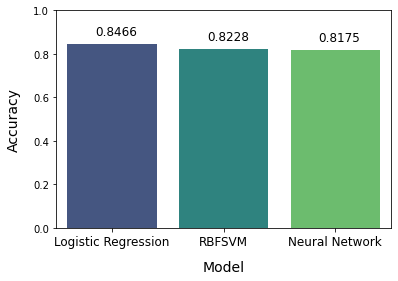

In [39]:
# X_2022, y_2022 = df_tfidf22, df22.label

# grid_search_LR = joblib.load("LR_Rerun.pkl")
# y_preds_LR = grid_search_LR.predict(X_2022)
# LR_2022 = accuracy_score(y_2022, y_preds_LR)

# grid_search_RBFSVM = joblib.load("RBFSVM_Rerun.pkl")
# y_preds_RBFSVM = grid_search_RBFSVM.predict(X_2022)
# RBFSVM_2022 = accuracy_score(y_2022, y_preds_RBFSVM)

# grid_search_MLP = joblib.load('grid_search_MLP_final.pkl')
# y_preds_MLP = grid_search_MLP.predict(X_2022)
# MLP_2022 = accuracy_score(y_2022, y_preds_MLP)

# df22_summary = pd.Series([LR_2022, RBFSVM_2022, MLP_2022])
# df22_summary.to_pickle("df22_summary.pkl")
df22_summary = pd.read_pickle("df22_summary.pkl").to_list()

fig, ax = plt.subplots(figsize=(6, 4))

sns.barplot(x=["Logistic Regression", "RBFSVM", "Neural Network"],
            y=df22_summary, palette='viridis', ax=ax)

# ax.set_box_aspect(0.8)
ax.set_ylim(0, 1)
xlocs, xlabs = plt.xticks()

for i, v in enumerate([round(df22_summary[0], 4), round(df22_summary[1], 4), round(df22_summary[2], 4)]):
    plt.text(xlocs[i] - 0.15, v + 0.04, str(v), fontsize=12)
    
plt.ylabel('Accuracy', fontsize=14, labelpad=12)
plt.xlabel('Model', fontsize=14, labelpad=12)
plt.xticks(fontsize=12)
plt.show()

## 7. Findings on Model Intepretability

Considering that this use case touches on expressions of political opinions and free speech, coming up with an accurate model is of limited use and will likely not be very acceptable among stakeholders, if it fails to be transparent and provide insight into what constitutes predictions of hate speech. Hence we turn to methods such as `SHAP` and `LIME` to provide interpretations on how the model yields predictions. Initially, we apply this on a global scale and extract the most important features of the overall model using SHAP values. We then proceed to examine certain tweets using LIME TextExplainer to understand how the model parses words to assign hate and non-hate classifications.

### 7.1 Global Intepretability Using SHAP on the 2016 Holdout Set

Upon selecting the best model and parameters, we construct a SHAP beeswarm summary plot on the 2016 holdout set to interpret the results. While some results were expected, such as the prevalence of swear words in predicted hate speech, some other results were not quite expected. We list these key findings and interesting insights below:
1. <b> Website links indicate that a post is non-hateful </b> - High values of `http` result in lower impact to model prediction. Netizens who share data sources may be more critical or seek to inform others, and are thus less hateful in their posts.<br><br>
2. <b> "Nognog" was a popular derogatory term in Halalan 2016 </b> -  `nognog` and `nognoghambog` are among the top features where high values lead to positive impact on model prediction. This suggests the emergence of phrase/s to mock candidate/s during elections.<br><br>
3. <b> Mar Roxas is the only candidate whose name led to predictions of hate speech </b> - `mar` and `mar roxas` indicate hate speech, while all other candidates such as `poe`, `vp binay`, `miriam` all indicate non-hate speech. Despite strong popularity, Mar Roxas may be vilified by netizens.<br><br>
4. <b> However, Leni's inclusion with Mar indicates non-hate speech </b> - While Mar's name lead to hateful speech, Leni Robredo's association with Mar in `roxasrobredo` suggest non-hate speech. The tandem may benefit Mar more than Leni.<br><br>
5. <b> Anti-"dilaw" sentiment and dislike towards commercials were prevalent </b> `ayawsadilaw`, `commercial`, and `ad` all have positive impact on model prediction. This highlights the negative sentiment towards the Liberal Party. Moreover, political ads must be prepared with caution since it may backfire and lead to hate among netizens towards a candidate.<br><br>
6. <b> Only Duterte's supporters identify their hate speech with their candidate's hashtag </b> - Other candidates' hashtags such as `onlybinayinmakatisankapa` and `roxasrobredo` indicate non-hate speech as supporters express their support under the hashtag. However, Duterte's supporters hate on other candidates under their own candidate's hashtag `dutertetiltheend`.

**Figure 14. SHAP Summary Plot on 2016 Election Data**

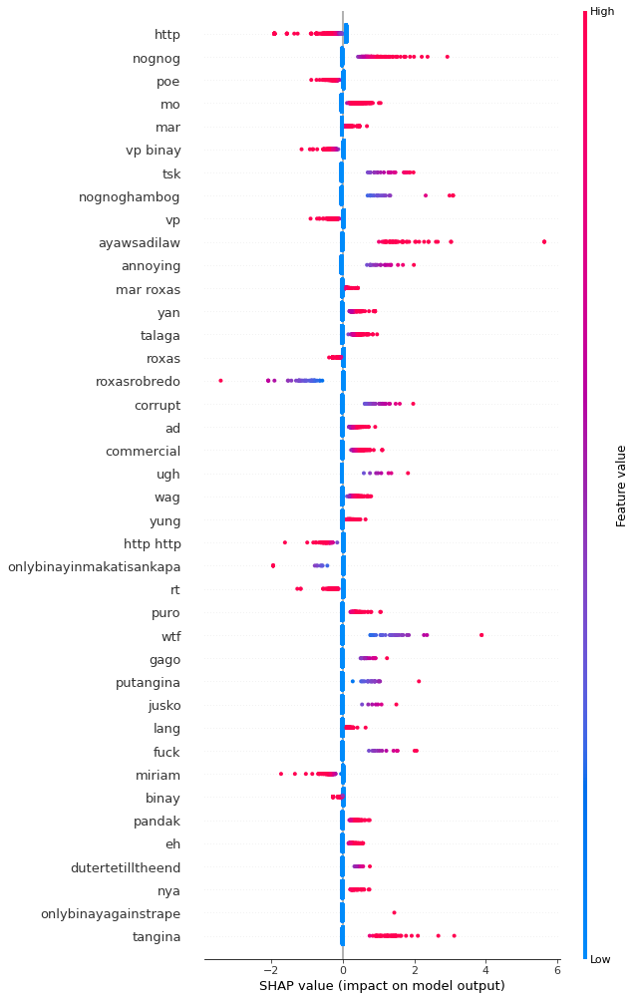

In [40]:
model = LogisticRegression(C=1, penalty='l2', solver='liblinear')
model.fit(X_trainval, y_trainval)

explainer = shap.LinearExplainer(
    model, X_trainval, feature_names = X_trainval.columns)
shap_values = explainer.shap_values(X_holdout)
shap.summary_plot(shap_values, X_holdout, max_display=40)

### 7.2 Local Intepretability Using LIME on the 2016 Holdout Set

For local interpretability, we use LIME as it has a TextExplainer specifically for NLP problems. The text plot highlights the keywords' effect on model prediction where keywords shown in orange lead to stronger hate prediction, while keywords shown in blue lead to stronger non-hate prediction. In this section, we show sample tweets that are correctly predicted and labeled as hate speech for each major presidential candidate in the 2016 elections.

***Note to Reader:*** *LIME Interpretability plots may not render on the Jupyter notebook without re-running the notebook. To view the plots, please refer to the accompanying HTML file.*

In [41]:
c = make_pipeline(tfidfvec, model)
class_names=list(df.label.unique())
explainer = LimeTextExplainer(class_names=class_names)

#### 7.2.1 Jejomar Binay 

Netizens hate his TV ads. The keywords `commercial` and `ad` are evident in Binay-related tweets which strongly lead to hateful prediction.

**Figure 15. Local Interpretation: Binay-related Tweet (10289)**

In [42]:
idx = X_holdout.index[8]
exp = explainer.explain_instance(df['lemmatized'].loc[idx], c.predict_proba)
print('Document no:', idx)
print('Predicted class:', class_names[model.predict(X_holdout.loc[idx].values.reshape(1,-1))[0]])
print('True class:', class_names[y_holdout[idx]])
exp.show_in_notebook(text=True)

Document no: 10289
Predicted class: 1
True class: 1


**Figure 16. Local Interpretation: Binay-related Tweet (10442)**

In [43]:
idx = X_holdout.index[12]
exp = explainer.explain_instance(df['lemmatized'].loc[idx], c.predict_proba)
print('Document no:', idx)
print('Predicted class:', class_names[model.predict(X_holdout.loc[idx].values.reshape(1,-1))[0]])
print('True class:', class_names[y_holdout[idx]])
exp.show_in_notebook(text=True)

Document no: 10442
Predicted class: 1
True class: 1


#### 7.2.2 Mar Roxas

People love to hate on Mar Roxas, particularly the supporters of Duterte. Presence of Mar's name leads to stronger prediction of hateful speech.

**Figure 17. Local Interpretation: Roxas-related Tweet (14954)**

In [44]:
idx = X_holdout.index[24]
exp = explainer.explain_instance(df['lemmatized'].loc[idx], c.predict_proba)
print('Document no:', idx)
print('Predicted class:', class_names[model.predict(X_holdout.loc[idx].values.reshape(1,-1))[0]])
print('True class:', class_names[y_holdout[idx]])
exp.show_in_notebook(text=True)

Document no: 14954
Predicted class: 1
True class: 1


**Figure 18. Local Interpretation: Roxas-related Tweet (11451)**

In [45]:
idx = X_holdout.index[27]
exp = explainer.explain_instance(df['lemmatized'].loc[idx], c.predict_proba)
print('Document no:', idx)
print('Predicted class:', class_names[model.predict(X_holdout.loc[idx].values.reshape(1,-1))[0]])
print('True class:', class_names[y_holdout[idx]])
exp.show_in_notebook(text=True)

Document no: 11451
Predicted class: 1
True class: 1


#### 7.2.3 Rodrigo Duterte 

Rather than hate tweets directed at Duterte, majority of the hate tweets that mention Duterte are from his supporters who attack on other candidates in his defense.

**Figure 19. Local Interpretation: Duterte-related Tweet (11982)**

In [46]:
hate_list = y_holdout[y_holdout==1].index.tolist()
df_hate_tweets = df.loc[hate_list]
duterte_hate_list = df_hate_tweets[df_hate_tweets.lemmatized.str.contains("duterte")].index.tolist()
idx = df.loc[duterte_hate_list[23]].name
exp = explainer.explain_instance(df['lemmatized'].loc[idx], c.predict_proba)
print('Document no:', idx)
print('Predicted class:', class_names[model.predict(X_holdout.loc[idx].values.reshape(1,-1))[0]])
print('True class:', class_names[y_holdout[idx]])
exp.show_in_notebook(text=True)

Document no: 11982
Predicted class: 1
True class: 1


**Figure 20. Local Interpretation: Duterte-related Tweet (11451)**

In [47]:
idx = df.loc[duterte_hate_list[2]].name
exp = explainer.explain_instance(df['lemmatized'].loc[idx], c.predict_proba)
print('Document no:', idx)
print('Predicted class:', class_names[model.predict(X_holdout.loc[idx].values.reshape(1,-1))[0]])
print('True class:', class_names[y_holdout[idx]])
exp.show_in_notebook(text=True)

Document no: 11451
Predicted class: 1
True class: 1


#### 7.2.4 Grace Poe

Hate tweets involving Grace Poe call on either Mar Roxas or Grace Poe to make way for the other candidate.

**Figure 21. Local Interpretation: Poe-related Tweet (16872)**

In [48]:
idx = 16872

exp = explainer.explain_instance(df['lemmatized'].loc[idx], c.predict_proba)
print('Document no:', idx)
print('Predicted class:', class_names[model.predict(X_holdout.loc[idx].values.reshape(1,-1))[0]])
print('True class:', class_names[y_holdout[idx]])
exp.show_in_notebook(text=True)

Document no: 16872
Predicted class: 1
True class: 1


**Figure 22. Local Interpretation: Poe-related Tweet (13339)**

In [49]:
idx = 13339

exp = explainer.explain_instance(df['lemmatized'].loc[idx], c.predict_proba)
print('Document no:', idx)
print('Predicted class:', class_names[model.predict(X_holdout.loc[idx].values.reshape(1,-1))[0]])
print('True class:', class_names[y_holdout[idx]])
exp.show_in_notebook(text=True)

Document no: 13339
Predicted class: 1
True class: 1


### 7.3 Global Intepretability Using SHAP on the 2022 Holdout Set

We similarly perform SHAP on the 2022 election-related tweets based on the model trained on 2016 data. While this is a much smaller dataset, we still find some fresh insights, as listed below:

1. <b> Contrary to 2016 results, website links now indicate that a post is hateful </b> - Contrary to 2016 results, high values of `https` result in higher impact on model prediction. A possible explanation for this occurence may be the rise of fake news, or that there is a shift in online behavior wherein news sources are being weaponized to attack other candidates or their supporters.

2. <b> VP Leni indicates non-hate speech </b> - High values for `leni` and `vp` lead to lower impact on model prediction. This suggests that Leni Robredo is viewed favorably by netizens. 

3. <b>  "BBM" indicates hate speech, but "bongbong" indicates non-hate speech </b> - Marcos Jr. may have different name recall or branding based on voter preference. His supporters may refer to him as `bongbong`, while his opposition refer to him as `bbm`.

**Figure 23. SHAP Summary Plot on 2022 Election Data**

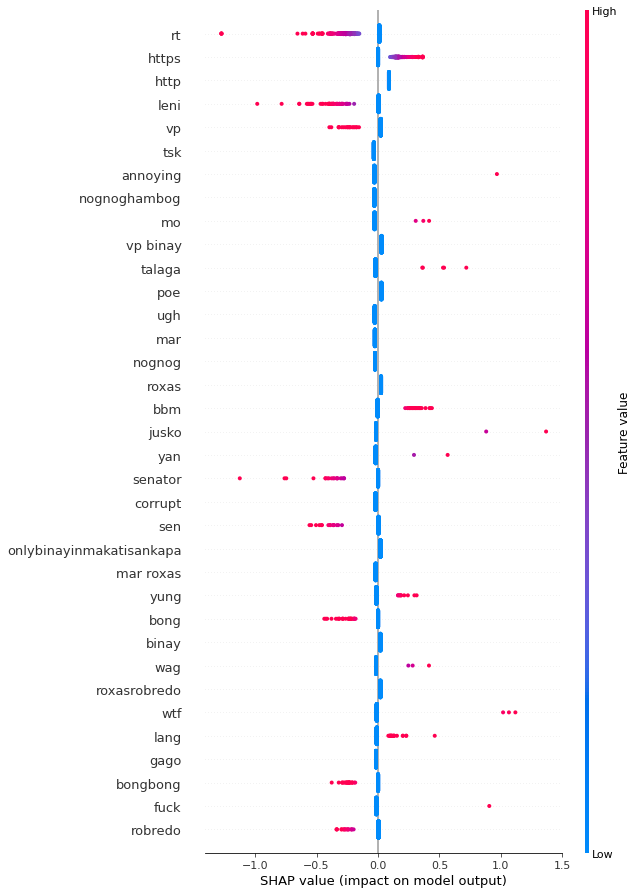

In [50]:
explainer = shap.LinearExplainer(
    model, X_trainval, feature_names = X_trainval.columns)

df_2022 = pd.read_csv('2022_elections.csv')
df_2022['text'] = df_2022['text'].replace(r'\n', ' ', regex=True) 
df_2022['text'] = df_2022['text'].replace(r'\t', ' ', regex=True) 
df_2022['text'] = df_2022['text'].replace(r' \d+', ' ', regex=True)
df_2022['text'] = df_2022['text'].replace(r"'", '', regex=True)
df_2022['text'] = df_2022['text'].replace(r"’", '', regex=True)
df_2022['text'] = df_2022['text'].replace(r'/t', ' ', regex=True)
df_2022['text'] = df_2022['text'].str.lower()

df_2022_tfidf = tfidfvec.transform(df_2022['text']).toarray()
cols = X_holdout.columns

shap_values_2022 = explainer.shap_values(df_2022_tfidf)

shap.summary_plot(
    shap_values_2022,
    features=df_2022_tfidf,
    feature_names=cols,
    max_display=35)

### 7.4 Local Intepretability Using LIME on the 2022 Holdout Set

We likewise perform Lime for local interpretability on the 2022 Elections dataset. In this section, we show sample tweets that are correctly predicted and labeled as hate speech for 2 leading presidential candidate in the 2022 elections.

***Note to Reader:*** *LIME Interpretability plots may not render on the Jupyter notebook without re-running the notebook. To view the plots, please refer to the accompanying HTML file.*

In [51]:
c = make_pipeline(tfidfvec, model)
class_names=list(df.label.unique())
explainer = LimeTextExplainer(class_names=class_names)

#### 7.4.1 Leni Robredo

Rather than hating on Leni Robredo herself, hate is directed towards her supporters in the sampled tweets. Sample tweets also suggest a division among social classes.

**Figure 24. Local Interpretation: Robredo-related Tweet (302)**

In [52]:
idx = 302

exp = explainer.explain_instance(df_2022['text'].iloc[idx], c.predict_proba)
print('Document no:', idx)
print('Predicted class:', class_names[model.predict(df_2022_tfidf[idx].reshape(1,-1))[0]])
print('True class:', class_names[df_2022.loc[idx, 'label']])
exp.show_in_notebook(text=True)

Document no: 302
Predicted class: 1
True class: 1


**Figure 25. Local Interpretation: Robredo-related Tweet (295)**

In [53]:
idx = 295

exp = explainer.explain_instance(df_2022['text'].iloc[idx], c.predict_proba)
print('Document no:', idx)
print('Predicted class:', class_names[model.predict(df_2022_tfidf[idx].reshape(1,-1))[0]])
print('True class:', class_names[df_2022.loc[idx, 'label']])
exp.show_in_notebook(text=True)

Document no: 295
Predicted class: 1
True class: 1


#### 7.4.2 Bongbong Marcos Jr.

Netizens attack him on corruption or the fake diploma controversy. The keywords `fake` and `korap` in Marcos-related tweets lead to hateful predictions. Interestingly, his association with Arroyo likewise lead to hateful predictions.

**Figure 26. Local Interpretation: Marcos-related Tweet (102)**

In [54]:
idx = 102

exp = explainer.explain_instance(df_2022['text'].iloc[idx], c.predict_proba)
print('Document no:', idx)
print('Predicted class:', class_names[model.predict(df_2022_tfidf[idx].reshape(1,-1))[0]])
print('True class:', class_names[df_2022.loc[idx, 'label']])
exp.show_in_notebook(text=True)

Document no: 102
Predicted class: 1
True class: 1


**Figure 27. Local Interpretation: Marcos-related Tweet (265)**

In [55]:
idx = 265

exp = explainer.explain_instance(df_2022['text'].iloc[idx], c.predict_proba)
print('Document no:', idx)
print('Predicted class:', class_names[model.predict(df_2022_tfidf[idx].reshape(1,-1))[0]])
print('True class:', class_names[df_2022.loc[idx, 'label']])
exp.show_in_notebook(text=True)

Document no: 265
Predicted class: 1
True class: 1


## 8. Conclusions and Key Takeaways

### 8.1 Summary of Learnings

Overall, the study shows that with sufficient data and by using appropriate natural language processing techniques, it is indeed possible to build machine learning models that can identify whether a tweet or social media post is used to bash political candidates or other netizens. It is highly likely that the same approach can be used in other domains as well, to flag bullying or hate speech related to non-political content.

By testing different classifier models on a balanced dataset of over 18,000 tweets, we found not just one but multiple models that achieved similar accuracies of 73% to 76%, well over the benchmark identified using the Proportional Chance Criterion (PCC). However out of all the models that performed well, only Logistic Regression achieved very high computational efficiency, making it ideal for deployment.

More significantly, it was found that model interpretation techniques are invaluable for topics like this, that are socially or politically sensitive, or requires stakeholder acceptance. SHAP and LIME proved very useful in deriving real-world insights on a global and local scale, respectively.

To outline some of our findings:
- Netizens gravitate towards certain keywords and nicknames when bashing candidates (or in the case of Mar Roxas, his actual name).
- Certain sectors tend to bash supporters or political affiliations of candidates, rather than candidates themselves. Pro-candidate campaign hashtags can even be used in such bashing tweets.
- Advertisements can backfire on a candidate, if they prove to be repetitive or annoying.
- Depending on the election, netizens may have a tendency to use website links legitimately, or weaponize these in a ridiculing or offensive manner.

One main contribution we sought to make beyond simply building and training a classifier model was to check on whether it functions well on social media behavior taking place six years later, in relation to another election with a brand new set of presidential candidates. There are some indications that the model trained on 2016 election data indeed works for the 2022 elections, although only limited (and imbalanced) 2022 data was available due the challenge of manually extracting and labeling tweets. More data would be highly useful to build greater confidence in evaluating model performance on the 2022 elections. Alternatively, the model could always be re-trained on new data to avoid model drift and capture shifting online behaviors.

### 8.2 Business Value

It is hoped that the classifier model built and the interpretability techniques used in this study will add value in the following areas:

1. **Provide users options to create safe spaces for themselves.** While providing blanket filtering at the social media platform level may be considered as controversial, providing users with browser extensions or configurable settings may help netizens manage the type and level of political discourse they might wish to engage in their respective social media feeds.<br><br>

2. **Gauge public sentiment.** Instead of filtering out hate speech, campaign professionals, political analysts, and other interested parties may apply the model to actively look for hate speech, to understand what detractors and critics are saying, and how these negative sentiments are being expressed on social media.<br><br>

3. **Learn from history.** Much of social interaction now takes places online, where opinions are formed, expressed, and spread (sometimes virally). Dissecting hate speech will not only help us gain insight on building positive yet effective campaigns, it may also help us to understand how social media shaped past elections, and therefore the course of the nation's history.

### 8.3 Areas for Further Study

This study aimed to supplement a previous study conducted by Cabasag et. al., who prepared the original 2016 election-related dataset, and similarly analyzed it using different machine learning models. Unique contributions to existing research literature was accomplished in this study primarily by:
1. Applying model interpretability methods such as SHAP and LIME
2. Using the model on 2022-election related data

That said, to better gauge the applicability of the model on other election data in future researches, we consider it highly useful to explore the following:

- Evaluating the model based on a larger 2022 election-related dataset, to be mined closer to election date
- Evaluating on other electoral races, including local elections or non-presidential races
- Re-training a new model on a larger dataset of 2022 election-related tweets, applying rebalancing techniques as needed, and comparing the change in performance against a model trained only on 2016 data
- Exploring semi-supervised learning techniques to reduce reliance on pre-labeled data
- Evaluating models based on other performance metrics, such as Recall, F1 Score, and Geometric Mean

## References

Cabasag, N. V., Chan, V. R., Lim, S. C., Gonzales, M. E., & Cheng, C. (2019). Hate speech in philippine election-related tweets: Automatic detection and classification using natural language processing. Philippine Computing Journal, XIV No, 1.

Cruz, J. C., Dataset Card for Hate Speech in Filipino, https://github.com/huggingface/datasets/blob/master/datasets/hate_speech_filipino/README.md